In [22]:
# Basic imports
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings("ignore")
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, f1_score
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.pipeline import Pipeline
import joblib
%matplotlib inline

In [5]:
# Load datasets (adjust paths if needed)
df_dos = pd.read_csv("Dos1.csv")
df_malfuction = pd.read_csv("Malfunction1.csv")
df_normal = pd.read_csv("Normal1.csv")
print('Loaded shapes:')
print('Dos:', df_dos.shape)
print('Malfunction:', df_malfuction.shape)
print('Normal:', df_normal.shape)

Loaded shapes:
Dos: (17204, 79)
Malfunction: (9040, 79)
Normal: (11599, 79)


In [6]:
# Quick columns check
print('Number of columns: dos={}, mal={}, normal={}'.format(len(df_dos.columns), len(df_malfuction.columns), len(df_normal.columns)))
print('Do columns match exactly (dos vs mal):', all(df_malfuction.columns == df_dos.columns))
print('Do columns match exactly (dos vs normal):', all(df_normal.columns == df_dos.columns))
# Show first 3 columns and types to inspect potential non-numeric fields
print('df_dos.head(2)Dos columns sample and dtypes:', df_dos.dtypes.head(10))

Number of columns: dos=79, mal=79, normal=79
Do columns match exactly (dos vs mal): True
Do columns match exactly (dos vs normal): True
df_dos.head(2)Dos columns sample and dtypes: S.No                                       int64
setpoint_raw-global_Time                 float64
setpoint_raw-global_header.seq             int64
setpoint_raw-global_header.stamp.secs      int64
setpoint_raw-global_latitude             float64
setpoint_raw-global_longitude            float64
setpoint_raw-global_altitude             float64
battery_Time                             float64
battery_header.seq                       float64
battery_header.stamp.secs                float64
dtype: object


In [7]:
df_normal['label'] = 'Normal'
df_dos['label'] = 'DoS_Attack'
df_malfuction['label'] = 'Malfunction'
print(df_dos.columns)

Index(['S.No', 'setpoint_raw-global_Time', 'setpoint_raw-global_header.seq',
       'setpoint_raw-global_header.stamp.secs', 'setpoint_raw-global_latitude',
       'setpoint_raw-global_longitude', 'setpoint_raw-global_altitude',
       'battery_Time', 'battery_header.seq', 'battery_header.stamp.secs',
       'battery_voltage', 'battery_current', 'battery_temperature',
       'battery_percentage', 'global_position-local_Time',
       'global_position-local_header.seq',
       'global_position-local_header.stamp.secs',
       'global_position-local_pose.pose.position.x',
       'global_position-local_pose.pose.position.y',
       'global_position-local_pose.pose.position.z',
       'global_position-local_pose.pose.orientation.x',
       'global_position-local_pose.pose.orientation.y',
       'global_position-local_pose.pose.orientation.z',
       'global_position-local_twist.twist.linear.x',
       'global_position-local_twist.twist.linear.y',
       'global_position-local_twist.twist.li

In [14]:
# Analyze missing values BEFORE forward-filling

datasets = {'DoS': df_dos, 'Malfunction': df_malfuction, 'Normal': df_normal}

for name, data in datasets.items():
    print(f"\n{'─' * 40}")
    print(f"📊 {name} Dataset: {data.shape}")
    print(f"{'─' * 40}")
    
    # Total missing
    total_missing = data.isna().sum().sum()
    total_cells = data.shape[0] * data.shape[1]
    print(f"Total missing: {total_missing:,} / {total_cells:,} ({100*total_missing/total_cells:.2f}%)")
    
    # Columns with missing values
    cols_with_na = (data.isna().sum() > 0).sum()
    print(f"Columns with NaN: {cols_with_na} / {data.shape[1]}")
    
    # Columns with >99% missing
    missing_pct = data.isna().sum() / len(data)
    cols_99_missing = (missing_pct > 0.9).sum()
    print(f"Columns with >90% missing: {cols_99_missing}")
    

    # Top 10 columns by missing count
    missing_counts = data.isna().sum().sort_values(ascending=False)
    top_missing = missing_counts[missing_counts > 0].head(10)
    if len(top_missing) > 0:
        print(f"\nTop 10 columns with missing values:")
        for col, count in top_missing.items():
            pct = 100 * count / len(data)
            print(f"  • {col}: {count:,} ({pct:.1f}%)")



────────────────────────────────────────
📊 DoS Dataset: (17204, 80)
────────────────────────────────────────
Total missing: 1,215,429 / 1,376,320 (88.31%)
Columns with NaN: 72 / 80
Columns with >90% missing: 72

Top 10 columns with missing values:
  • RSSI_Quality: 17,195 (99.9%)
  • RSSI_Signal: 17,195 (99.9%)
  • RSSI_Time: 17,195 (99.9%)
  • CPU_Time: 17,189 (99.9%)
  • CPU_Percent: 17,189 (99.9%)
  • state_Time: 17,163 (99.8%)
  • state_connected: 17,163 (99.8%)
  • state_header.seq: 17,163 (99.8%)
  • state_manual_input: 17,163 (99.8%)
  • state_guided: 17,163 (99.8%)

────────────────────────────────────────
📊 Malfunction Dataset: (9040, 80)
────────────────────────────────────────
Total missing: 626,219 / 723,200 (86.59%)
Columns with NaN: 72 / 80
Columns with >90% missing: 72

Top 10 columns with missing values:
  • RSSI_Quality: 9,031 (99.9%)
  • RSSI_Signal: 9,031 (99.9%)
  • RSSI_Time: 9,031 (99.9%)
  • CPU_Time: 9,025 (99.8%)
  • CPU_Percent: 9,025 (99.8%)
  • state_Time: 

In [16]:
colsToBackfill=df_normal.columns[7:]
df_normal[colsToBackfill] = df_normal[colsToBackfill].replace(r"^\s*$", np.nan, regex=True)
df_normal[colsToBackfill] = df_normal[colsToBackfill].ffill()
df_malfuction[colsToBackfill] = df_malfuction[colsToBackfill].replace(r"^\s*$", np.nan, regex=True)
df_malfuction[colsToBackfill] = df_malfuction[colsToBackfill].ffill()
df_dos[colsToBackfill] = df_dos[colsToBackfill].replace(r"^\s*$", np.nan, regex=True)
df_dos[colsToBackfill] = df_dos[colsToBackfill].ffill()



In [17]:
df=pd.concat([df_dos,df_malfuction,df_normal],ignore_index=True)
print(df.shape)

(37843, 80)


Missing values per column (top 10):
S.No                                     0
setpoint_raw-global_Time                 0
setpoint_raw-global_header.seq           0
setpoint_raw-global_header.stamp.secs    0
setpoint_raw-global_latitude             0
setpoint_raw-global_longitude            0
setpoint_raw-global_altitude             0
battery_Time                             0
battery_header.seq                       0
battery_header.stamp.secs                0
dtype: int64


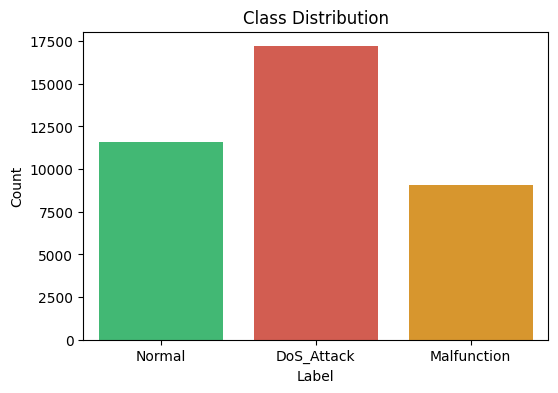

In [24]:
# Basic EDA: missing values and simple distributions
print('Missing values per column (top 10):')
print(df.isna().sum().sort_values(ascending=False).head(10))

plt.figure(figsize=(6,4))
palette = {'Normal': '#2ecc71', 'DoS_Attack': '#e74c3c', 'Malfunction': '#f39c12'}
sns.countplot(data=df, x='label', palette=palette, order=['Normal', 'DoS_Attack', 'Malfunction'])
plt.title('Class Distribution')
plt.xlabel('Label')
plt.ylabel('Count')
plt.show()

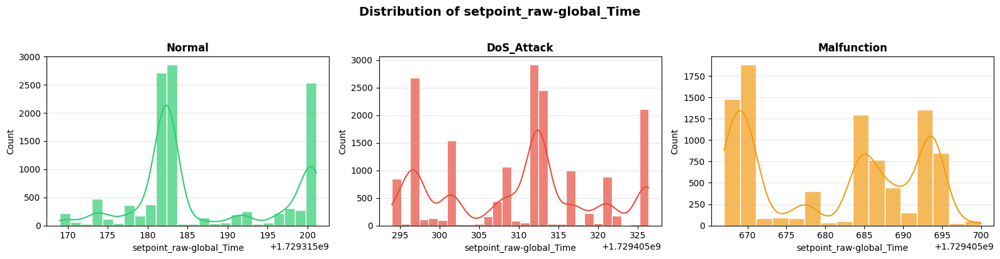

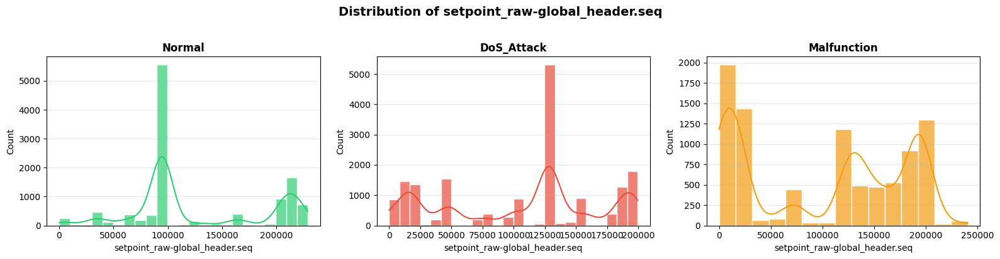

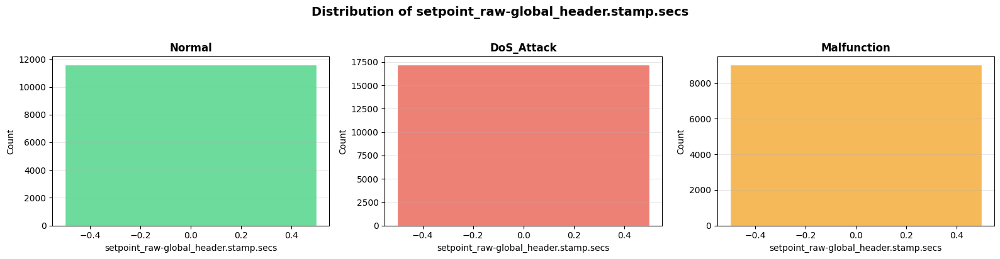

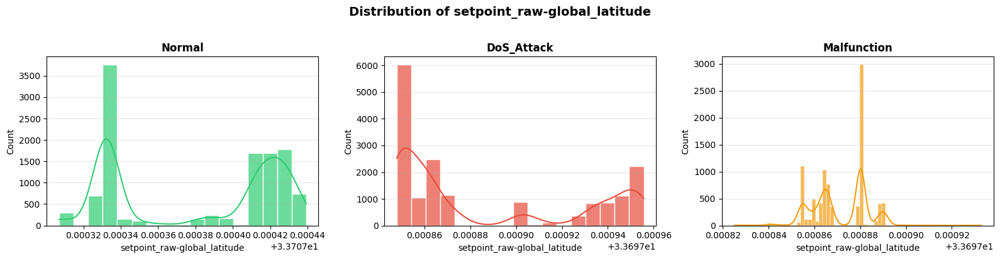

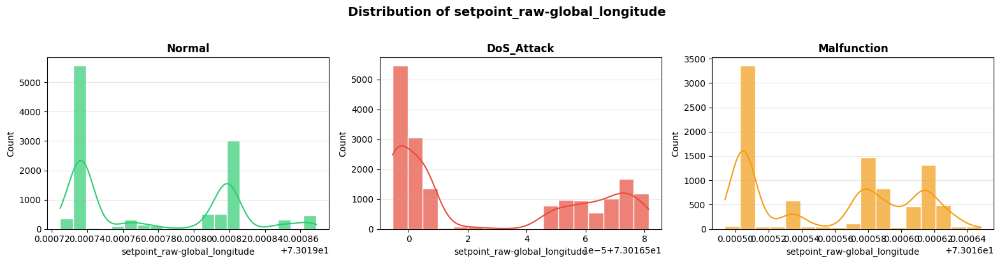

...

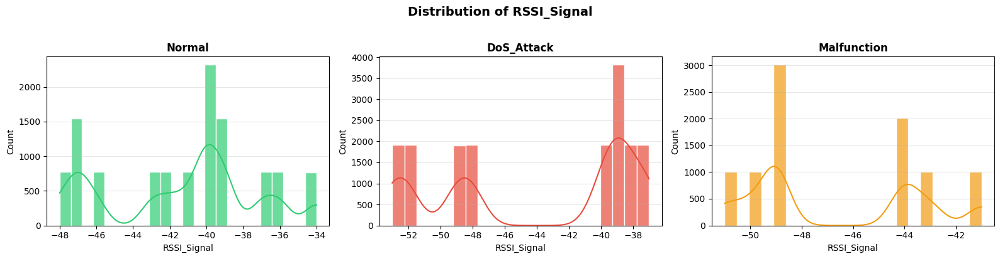

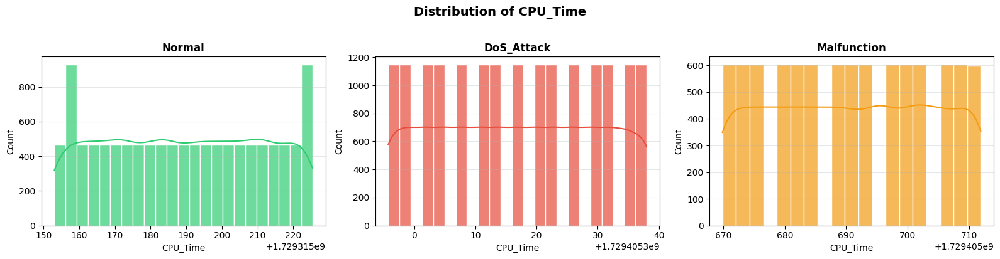

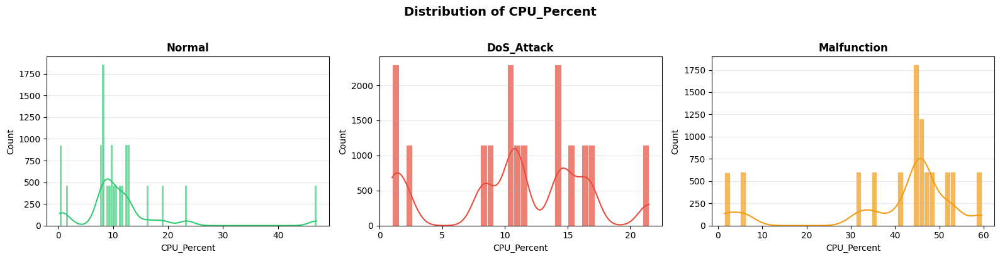

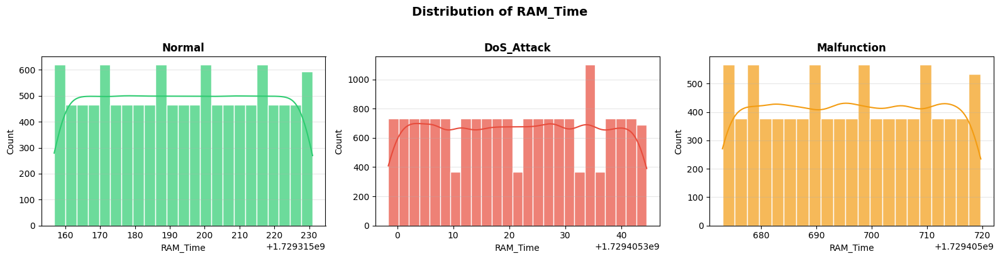

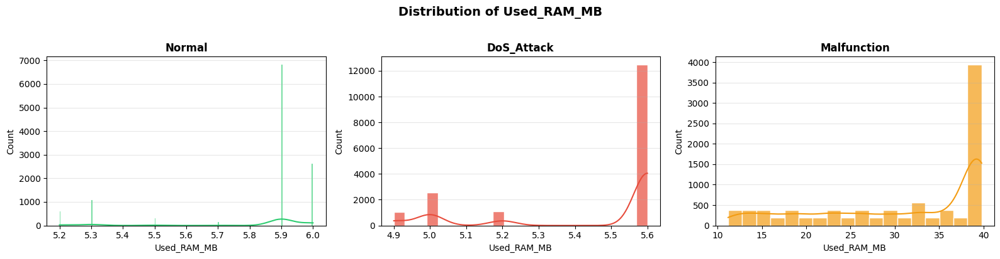

In [26]:
import matplotlib.pyplot as plt
import seaborn as sns

# Select only numeric columns (histograms make sense for numeric data)
num_cols = df.select_dtypes(include='number').columns

labels = ['Normal', 'DoS_Attack', 'Malfunction']
palette = {'Normal': '#2ecc71', 'DoS_Attack': '#e74c3c', 'Malfunction': '#f39c12'}

for col in num_cols:
    if col == 'S.No':
        continue
    fig, axes = plt.subplots(1, 3, figsize=(16, 4))
    for i, label in enumerate(labels):
        dfsmall = df[df['label'] == label]
        sns.histplot(
            data=dfsmall, 
            x=col, 
            color=palette[label], 
            kde=True,  # add density curve
            ax=axes[i],
            edgecolor='white',
            alpha=0.7
        )
        axes[i].set_title(f'{label}', fontsize=12, fontweight='bold')
        axes[i].set_xlabel(col, fontsize=10)
        axes[i].set_ylabel('Count', fontsize=10)
        axes[i].grid(axis='y', alpha=0.3)
    
    fig.suptitle(f'Distribution of {col}', fontsize=14, fontweight='bold', y=1.02)
    plt.tight_layout()
    plt.show()

label
DoS_Attack     17204
Normal         11599
Malfunction     9040
Name: count, dtype: int64


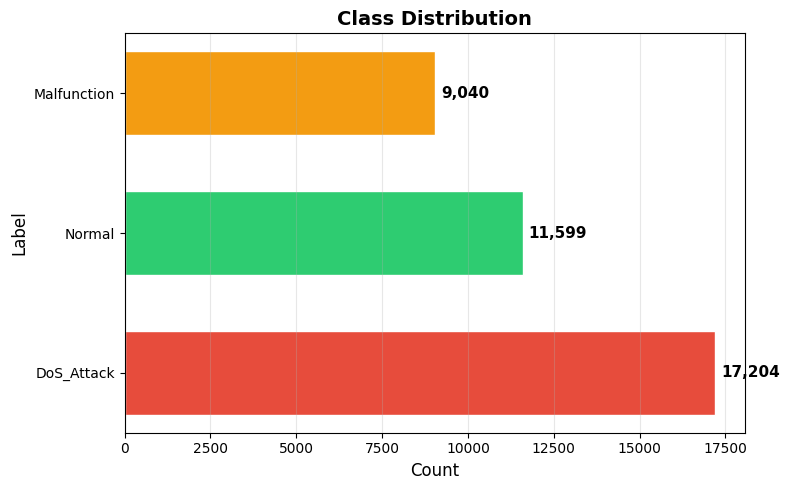

In [29]:
vc = df.label.value_counts()
print(vc)

# Define colors matching your palette
colors = {'Normal': '#2ecc71', 'DoS_Attack': '#e74c3c', 'Malfunction': '#f39c12'}
bar_colors = [colors.get(label, '#3498db') for label in vc.index]

plt.figure(figsize=(8, 5))
bars = plt.barh(vc.index, vc.values, color=bar_colors, edgecolor='white', height=0.6)

# Add value labels on bars
for bar, val in zip(bars, vc.values):
    plt.text(val + max(vc.values)*0.01, bar.get_y() + bar.get_height()/2, 
             f'{val:,}', va='center', fontsize=11, fontweight='bold')

plt.xlabel('Count', fontsize=12)
plt.ylabel('Label', fontsize=12)
plt.title('Class Distribution', fontsize=14, fontweight='bold')
plt.grid(axis='x', alpha=0.3)
plt.tight_layout()
plt.show()

<Axes: xlabel='setpoint_raw-target_global_longitude', ylabel='global_position-global_longitude'>

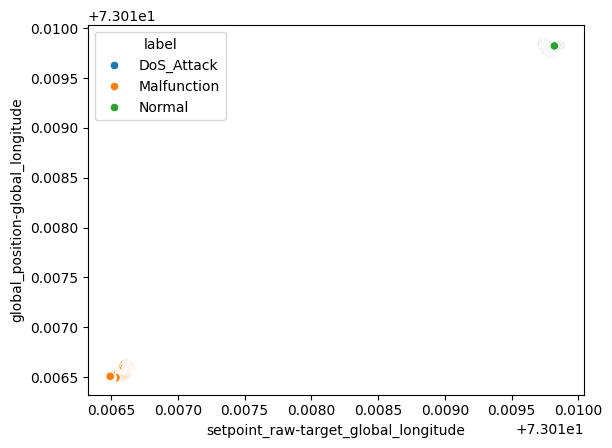

In [28]:
sns.scatterplot(x="setpoint_raw-target_global_longitude", y="global_position-global_longitude", hue='label', data=df)

<Axes: xlabel='setpoint_raw-target_global_latitude', ylabel='global_position-global_latitude'>

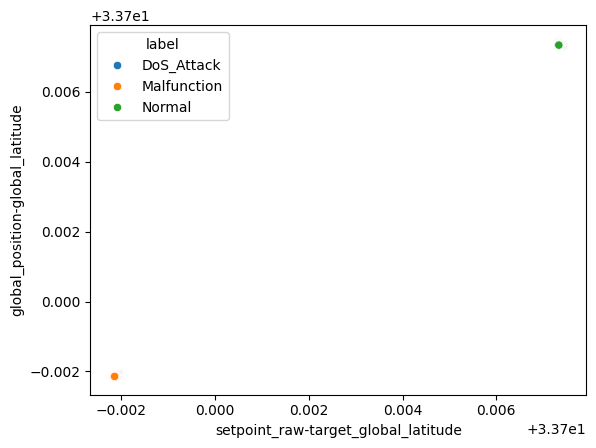

In [30]:
sns.scatterplot(x="setpoint_raw-target_global_latitude", y="global_position-global_latitude", hue='label', data=df)

In [ ]:
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.io as pio
pio.renderers.default = "notebook_connected"

# pio.renderers.default = "iframe_connected"
latLongCols = [c for c in df.columns if 'latitude' in c or 'longitude' in c]

for col in latLongCols:

    fig = px.scatter(df, x=col, y=col, color="label")
    fig.show()




hi


hi


hi


hi


hi


hi


In [16]:
fig = px.scatter(df, x='CPU_Percent', y='CPU_Percent', color="label")
fig.show()
fig = px.scatter(df, x='Used_RAM_MB', y='Used_RAM_MB', color="label")
fig.show()


In [ ]:
import plotly.express as px

# Extract columns
timeColumns = [c for c in df.columns if 'Time' in c]
sequenceColumns = [c for c in df.columns if '.seq' in c]

for seq_col in sequenceColumns:
    
    prefix = seq_col.split('.')[0].split("_hea")[0]   
    print(prefix)
    time_col = [t for t in timeColumns if prefix in t]
    print(time_col)

    if not time_col:
        continue  # no matching time column found

    time_col = time_col[0]  # use the first match

    fig = px.scatter(
        df,
        x=time_col,
        y=seq_col,
        color="label",
        title=f"{seq_col} vs {time_col}"
    )
    fig.show()


Time columns: ['setpoint_raw-global_Time', 'battery_Time', 'global_position-local_Time', 'imu-data_Time', 'rc-out_Time', 'vfr_hud_Time', 'setpoint_raw-target_global_Time', 'state_Time', 'RSSI_Time', 'CPU_Time', 'RAM_Time']
Sequence columns: ['setpoint_raw-global_header.seq', 'battery_header.seq', 'global_position-local_header.seq', 'imu-data_header.seq', 'rc-out_header.seq', 'vfr_hud_header.seq', 'setpoint_raw-target_global_header.seq', 'state_header.seq']
setpoint_raw-global
['setpoint_raw-global_Time']


battery
['battery_Time']


global_position-local
['global_position-local_Time']


imu-data
['imu-data_Time']


rc-out
['rc-out_Time']


vfr_hud
['vfr_hud_Time']


setpoint_raw-target_global
['setpoint_raw-target_global_Time']


state
['state_Time']


Numeric columns count: 79
Plotting columns found: ['battery_voltage', 'battery_current', 'battery_percentage', 'vfr_hud_airspeed', 'vfr_hud_groundspeed', 'RSSI_Quality', 'CPU_Percent', 'Used_RAM_MB']


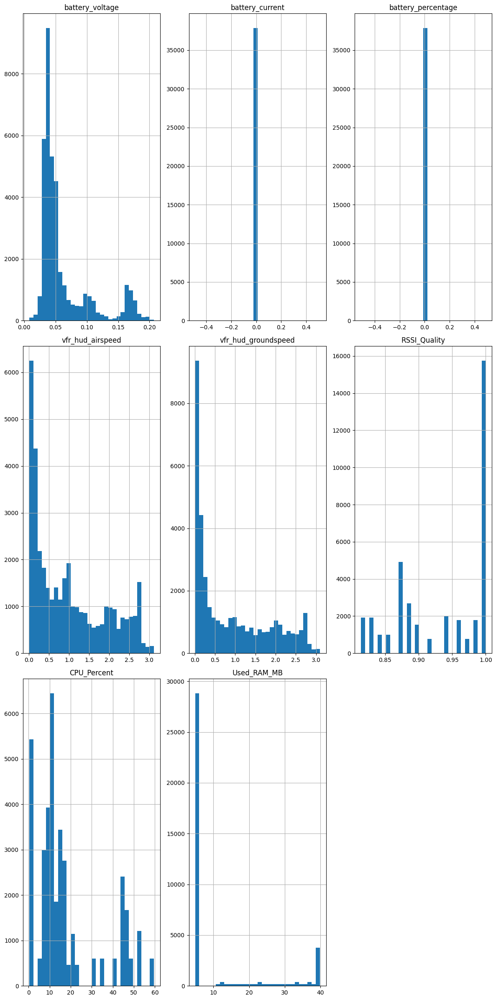


Sample rows:


,S.No,setpoint_raw-global_Time,setpoint_raw-global_header.seq,setpoint_raw-global_header.stamp.secs,setpoint_raw-global_latitude,setpoint_raw-global_longitude,setpoint_raw-global_altitude,battery_Time,battery_header.seq,battery_header.stamp.secs,...,state_manual_input,state_system_status,RSSI_Time,RSSI_Quality,RSSI_Signal,CPU_Time,CPU_Percent,RAM_Time,Used_RAM_MB,label
22023,4819,1.729406e+09,126460,0,33.697855,73.016576,6.443,1.729406e+09,8551.0,1.729406e+09,...,1.0,5.0,1.729406e+09,0.942857,-44.0,1.729406e+09,45.0,1.729406e+09,36.5,Malfunction
34133,7889,1.729315e+09,164592,0,33.707330,73.019811,7.997,1.729315e+09,15380.0,1.729315e+09,...,1.0,5.0,1.729315e+09,0.957143,-43.0,1.729315e+09,10.6,1.729315e+09,6.0,Normal
3594,3594,1.729405e+09,23713,0,33.697850,73.016495,2.293,1.729405e+09,4686.0,1.729405e+09,...,1.0,5.0,1.729405e+09,1.000000,-37.0,1.729405e+09,8.1,1.729405e+09,5.6,DoS_Attack
12296,12296,1.729405e+09,130993,0,33.697955,73.016548,5.865,1.729405e+09,4884.0,1.729405e+09,...,1.0,5.0,1.729405e+09,0.885714,-48.0,1.729405e+09,21.5,1.729405e+09,5.6,DoS_Attack
22277,5073,1.729406e+09,126900,0,33.697855,73.016577,6.442,1.729406e+09,8562.0,1.729406e+09,...,1.0,5.0,1.729406e+09,0.857143,-50.0,1.729406e+09,44.7,1.729406e+09,37.1,Malfunction


In [ ]:

numeric_cols = df.select_dtypes(include=[np.number]).columns.tolist()
print('Numeric columns count:', len(numeric_cols))

candidates = ['battery_voltage','battery_current','battery_percentage','vfr_hud_airspeed','vfr_hud_groundspeed','RSSI_Quality','CPU_Percent','Used_RAM_MB']
plot_cols = [c for c in candidates if c in df.columns]
print('Plotting columns found:', plot_cols)
if len(plot_cols) > 0:
    df[candidates].hist(bins=30, figsize=(12, 3*len(plot_cols)))
    plt.tight_layout()
    plt.show()
# If data is large, show a small sample of rows
print('\nSample rows:')
display(df.sample(min(5, len(df)), random_state=42))

In [25]:
def remove_outliers_by_label_loose(df, label_col, iqr_multiplier=3.0):
    numeric_cols = df.select_dtypes(include=[np.number]).columns.tolist()
    numeric_cols = [col for col in numeric_cols if col != label_col]
    
    cleaned_df = pd.DataFrame()
    
    for lbl in df[label_col].unique():
        subset = df[df[label_col] == lbl].copy()
        for col in numeric_cols:
            Q1 = subset[col].quantile(0.25)
            Q3 = subset[col].quantile(0.75)
            IQR = Q3 - Q1
            lower = Q1 - iqr_multiplier * IQR
            upper = Q3 + iqr_multiplier * IQR
            subset = subset[(subset[col] >= lower) & (subset[col] <= upper)]
        cleaned_df = pd.concat([cleaned_df, subset])
    
    return cleaned_df.reset_index(drop=True)

df_clean = remove_outliers_by_label_loose(df, 'label',20)
print('Original rows:', len(df), 'Cleaned rows:', len(df_clean))
df=df_clean


Original rows: 37843 Cleaned rows: 25393


In [26]:
threshold = 0.9
df = df.dropna(axis=1, thresh=int((1 - threshold) * len(df)))
drop_cols = [c for c in df.columns if ("_Time" in c) or (".seq" in c) or  (".secs" in c) or ("S.No" in c)]
print('Dropping columns:', drop_cols)
# df.drop(columns=['S.No'], inplace=True)
df.drop(columns=drop_cols, inplace=True)


Dropping columns: ['S.No', 'setpoint_raw-global_Time', 'setpoint_raw-global_header.seq', 'setpoint_raw-global_header.stamp.secs', 'battery_Time', 'battery_header.seq', 'battery_header.stamp.secs', 'global_position-local_Time', 'global_position-local_header.seq', 'global_position-local_header.stamp.secs', 'imu-data_Time', 'imu-data_header.seq', 'imu-data_header.stamp.secs', 'rc-out_Time', 'rc-out_header.seq', 'rc-out_header.stamp.secs', 'vfr_hud_Time', 'vfr_hud_header.seq', 'vfr_hud_header.stamp.secs', 'global_position-global_header.stamp.secs', 'setpoint_raw-target_global_Time', 'setpoint_raw-target_global_header.seq', 'setpoint_raw-target_global_header.stamp.secs', 'state_Time', 'state_header.seq', 'RSSI_Time', 'CPU_Time', 'RAM_Time']


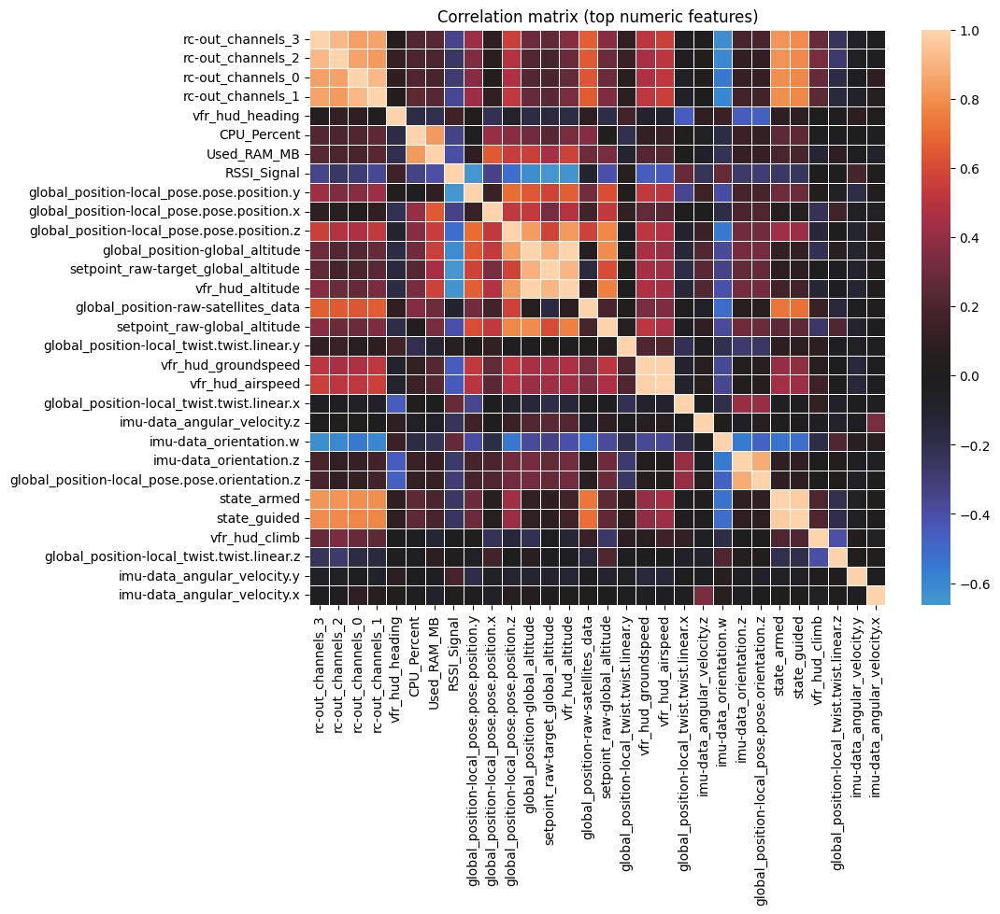

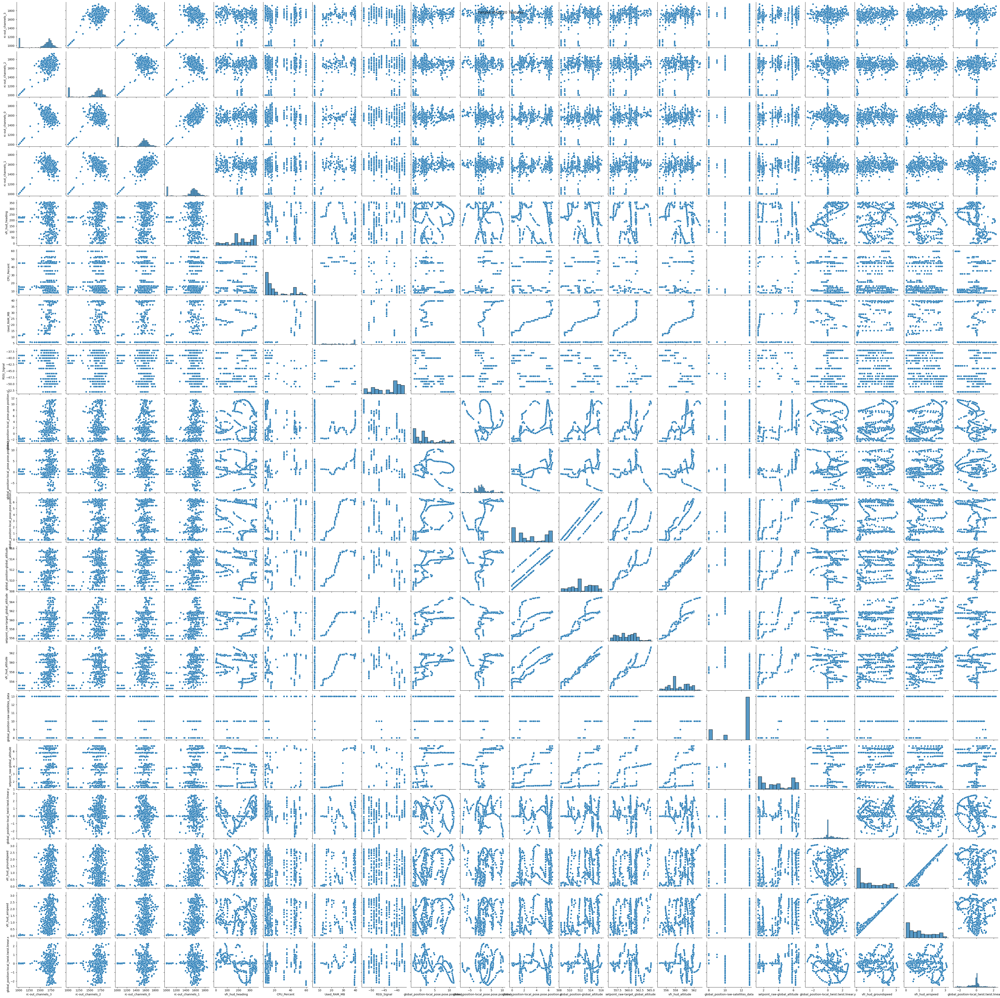

In [ ]:

numeric = df.select_dtypes(include=[np.number]).copy()
if numeric.shape[1] == 0:
    print('No numeric features available for correlation matrix')
else:
   
    var = numeric.var().sort_values(ascending=False)
    top_feats = var.head(30).index.tolist() if len(var) > 30 else var.index.tolist()
    corr = numeric[top_feats].corr()
    plt.figure(figsize=(10,8))
    sns.heatmap(corr, center=0, square=True, linewidths=.5)
    plt.title('Correlation matrix (top numeric features)')
    plt.show()
   
    if len(top_feats) >= 20:
        sample_df = numeric[top_feats[:20]].sample(min(1000, len(numeric)), random_state=42)
        sns.pairplot(sample_df)
        plt.suptitle('Pairplot of top 20  features')
        plt.show()

Potential time columns found: []
State columns candidates: ['state_connected', 'state_armed', 'state_guided', 'state_manual_input', 'state_system_status']

Value counts for state_connected
state_connected
1.0    25393
Name: count, dtype: int64

Value counts for state_armed
state_armed
1.0    22372
0.0     3021
Name: count, dtype: int64

Value counts for state_guided
state_guided
1.0    22531
0.0     2862
Name: count, dtype: int64

Value counts for state_manual_input
state_manual_input
1.0    25393
Name: count, dtype: int64

Value counts for state_system_status
state_system_status
5.0    25393
Name: count, dtype: int64


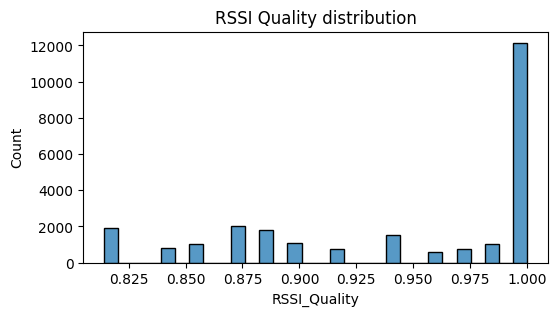


EDA complete. Next: feature engineering and preprocessing.


In [ ]:

time_cols = [c for c in df.columns if 'Time' in c or 'time' in c.lower() or 'stamp' in c.lower()]
print('Potential time columns found:', time_cols)

if len(time_cols) > 0:
    tcol = time_cols[0]
    try:
        df['_ts_parsed'] = pd.to_datetime(df[tcol], unit='s', errors='coerce')
        print('Parsed datetime from', tcol, ' — nulls:', df['_ts_parsed'].isna().sum())
        # plot CPU over time if available
        if 'CPU_Percent' in df.columns:
            sample = df[[ '_ts_parsed', 'CPU_Percent']].dropna().sort_values('_ts_parsed').head(5000)
            plt.figure(figsize=(12,3))
            plt.plot(sample['_ts_parsed'], sample['CPU_Percent'], marker='.', linestyle='-', markersize=2)
            plt.title('CPU Percent over time (sample)')
            plt.xlabel('time')
            plt.ylabel('CPU_Percent')
            plt.show()
    except Exception as e:
        print('Could not parse time column:', e)
# State columns distribution (boolean-like)
state_cols = [c for c in df.columns if c.lower().startswith('state') or c.lower().startswith('state_') or c.lower().startswith('state-') or c.lower().startswith('state ')]
print('State columns candidates:', state_cols)
for c in state_cols:
    print('\nValue counts for', c)
    print(df[c].value_counts(dropna=False).head(20))
# If RSSI exists, show distribution
if 'RSSI_Quality' in df.columns:
    plt.figure(figsize=(6,3))
    sns.histplot(df['RSSI_Quality'].dropna(), bins=30)
    plt.title('RSSI Quality distribution')
    plt.show()
print('\nEDA complete. Next: feature engineering and preprocessing.')

Counts by label:
label
DoS_Attack     11974
Malfunction     6908
Normal          6511
Name: count, dtype: int64
Numeric features count: 51


label,DoS_Attack,Malfunction,Normal
setpoint_raw-global_latitude,33.697890,33.697874,33.707407
setpoint_raw-global_longitude,73.016533,73.016553,73.019756
setpoint_raw-global_altitude,3.993921,4.044844,3.315906
battery_voltage,0.043031,0.051639,0.130533
battery_current,0.010000,0.010000,0.010000
battery_temperature,0.000000,0.000000,0.000000
battery_percentage,-0.010000,-0.010000,-0.010000
global_position-local_pose.pose.position.x,0.103651,3.891534,-0.265512
global_position-local_pose.pose.position.y,2.593516,1.770428,0.151185
global_position-local_pose.pose.position.z,3.381037,4.503789,0.777133


Top features by mean difference: ['rc-out_channels_3', 'rc-out_channels_2', 'rc-out_channels_1', 'rc-out_channels_0', 'vfr_hud_heading', 'CPU_Percent', 'Used_RAM_MB', 'RSSI_Signal', 'global_position-raw-satellites_data', 'global_position-local_pose.pose.position.x', 'global_position-local_pose.pose.position.z', 'global_position-local_pose.pose.position.y', 'setpoint_raw-target_global_altitude', 'vfr_hud_altitude', 'global_position-global_altitude', 'setpoint_raw-global_altitude', 'vfr_hud_airspeed', 'imu-data_orientation.w', 'vfr_hud_groundspeed', 'state_armed']


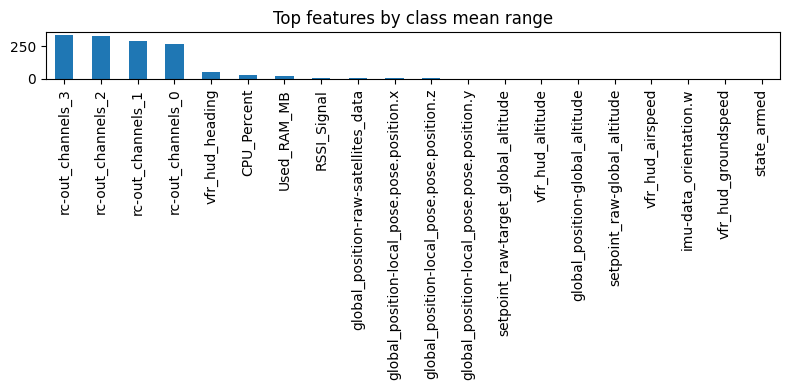

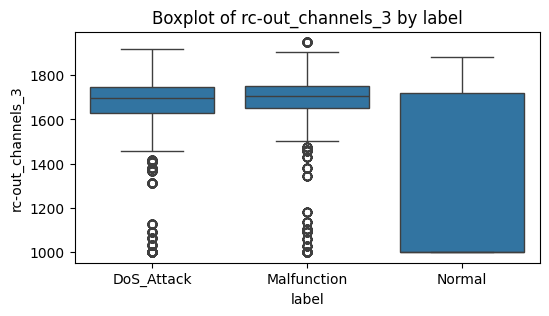

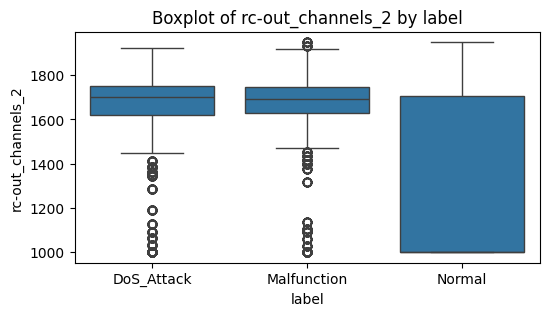

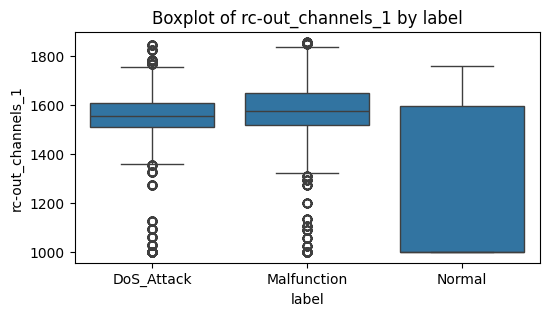

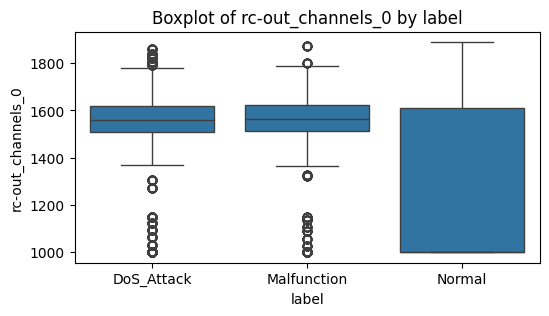

...

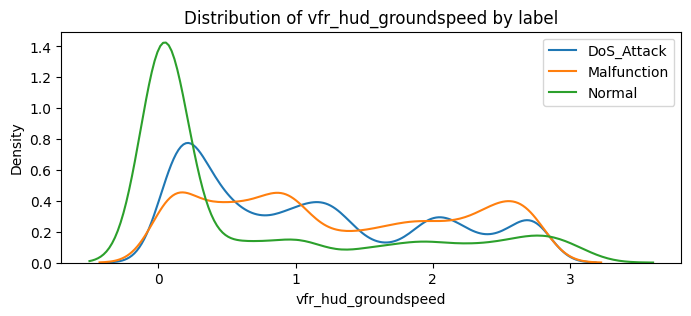

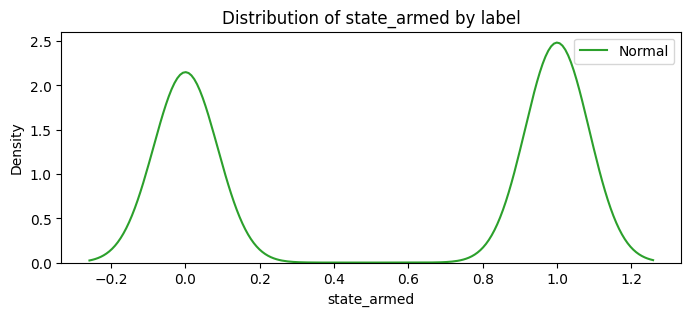

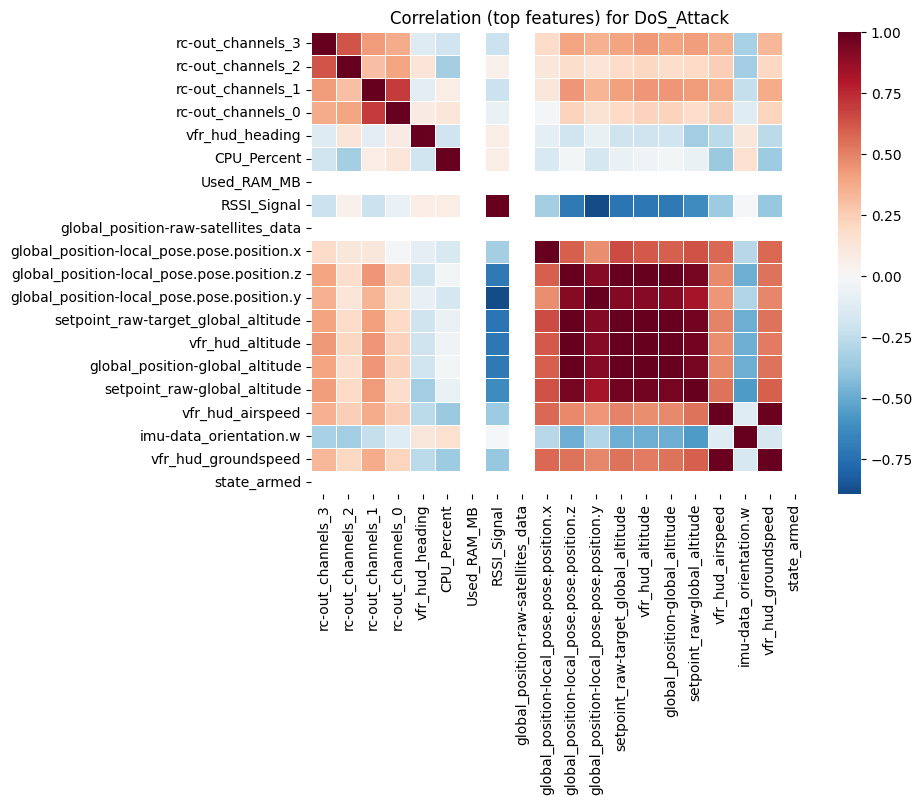

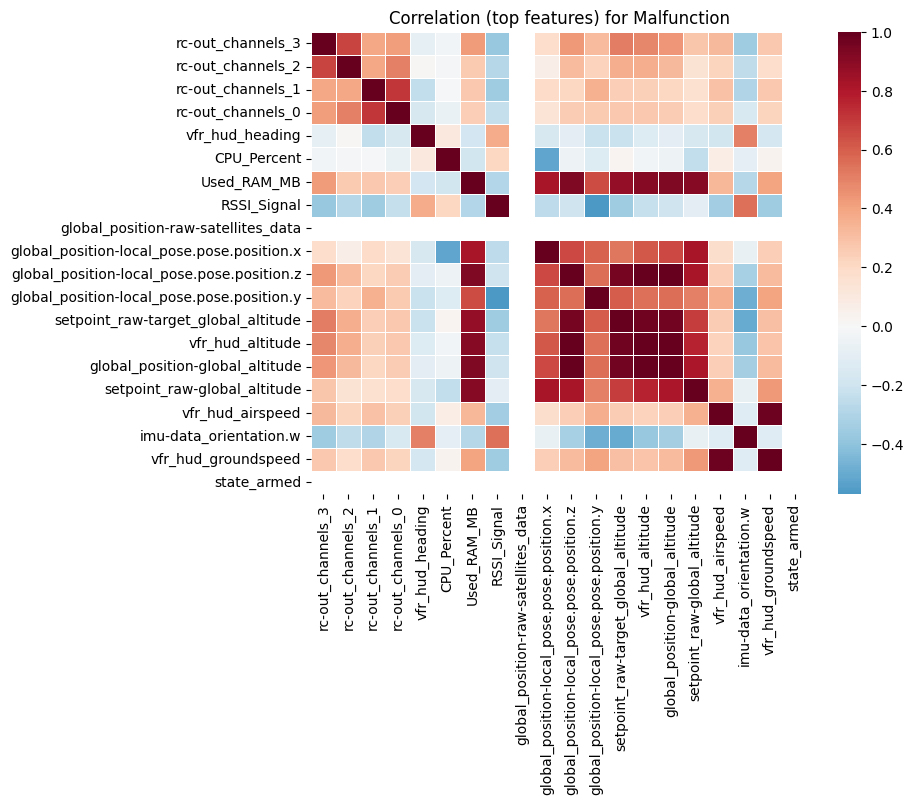

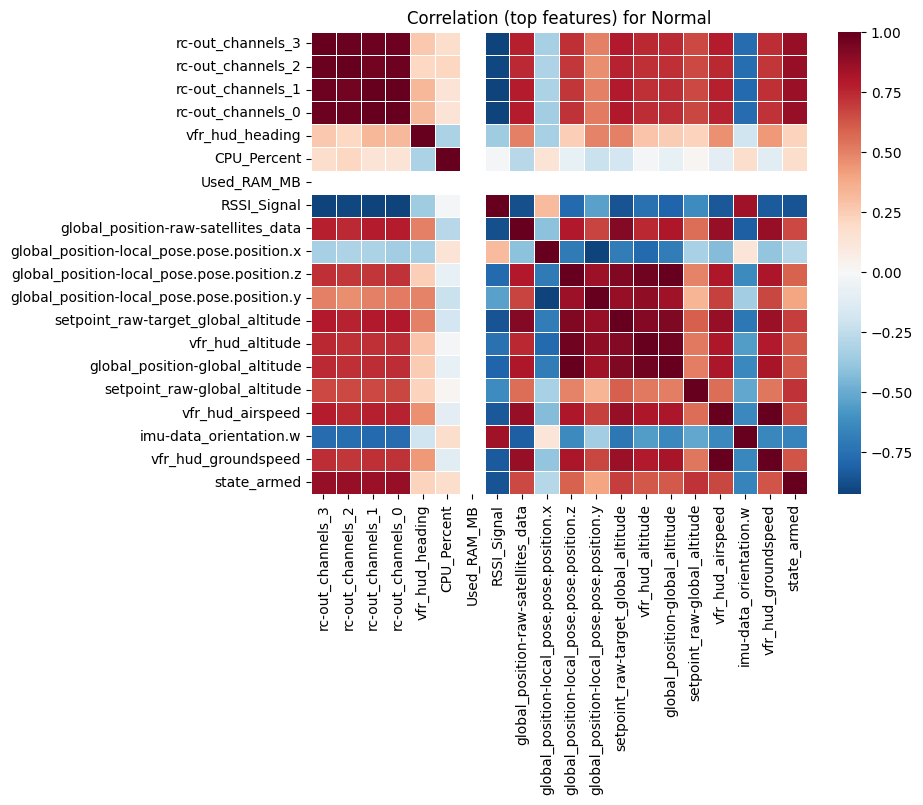


Label-wise EDA complete.


In [29]:
# EDA by label: group statistics and class-wise plots
print('Counts by label:')
vc = df['label'].value_counts()
print(vc)
# ensure numeric variable list available
numeric = df.select_dtypes(include=[np.number]).columns.tolist()
print('Numeric features count:', len(numeric))
# group means for numeric features
group_mean = df.groupby('label')[numeric].mean() if len(numeric)>0 else pd.DataFrame()
if not group_mean.empty:
    display(group_mean.T.head(20))
    # top features where class means differ the most
    range_per_feature = group_mean.max() - group_mean.min()
    top_diff = range_per_feature.sort_values(ascending=False).head(20).index.tolist()
    print('Top features by mean difference:', top_diff)
    plt.figure(figsize=(8,4))
    range_per_feature[top_diff].plot(kind='bar')
    plt.title('Top features by class mean range')
    plt.tight_layout()
    plt.show()
    # Boxplots for top features
    for feat in top_diff[:20]:
        plt.figure(figsize=(6,3))
        sns.boxplot(x='label', y=feat, data=df, order=sorted(df['label'].unique()))
        plt.title(f'Boxplot of {feat} by label')
        plt.show()
    # Class-wise KDE/histograms for top 4 features
    for feat in top_diff[:20]:
        plt.figure(figsize=(8,3))
        for lbl in sorted(df['label'].unique()):
            sns.kdeplot(df.loc[df['label']==lbl, feat].dropna(), label=lbl, fill=False)
        plt.title(f'Distribution of {feat} by label')
        plt.legend()
        plt.show()
    # Correlation heatmap per class (top features)
    for lbl in sorted(df['label'].unique()):
        sub = df[df['label']==lbl][top_diff[:20]]
        if sub.shape[0] > 10:
            plt.figure(figsize=(8,6))
            sns.heatmap(sub.corr(), cmap='RdBu_r', center=0, linewidths=.5)
            plt.title(f'Correlation (top features) for {lbl}')
            plt.show()
else:
    print('No numeric features available to compute group statistics.')
print('\nLabel-wise EDA complete.')

In [30]:
cols1 = (df.isna().sum() / len(df) > 0.90)
# print(len(df.columns))
print(len(df.columns[cols1]))





0


# Part 2: Models

In [ ]:
from sklearn.impute import SimpleImputer
# Shared preprocessing: select numeric features, impute, scale, and split
from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.preprocessing import StandardScaler
# select numeric features (drop identifiers and timestamps)
drop_cols = [c for c in df.columns if 'Time' in c or 'time' in c.lower() or 'seq' in c.lower() or c=='S.No' or c=='S.No.']
X = df.drop(columns=[c for c in drop_cols if c in df.columns] + ['label'], errors='ignore')

X = X.select_dtypes(include=[np.number]).copy()
y = df['label'].copy()
print('X shape (numeric only):', X.shape)
# encode labels
le = LabelEncoder()
y_enc = le.fit_transform(y)
print('Classes:', le.classes_)
# train/val/test split 70/15/15 stratified
X_train_full, X_test, y_train_full, y_test = train_test_split(X, y_enc, test_size=0.15, random_state=42, stratify=y_enc)
X_train, X_val, y_train, y_val = train_test_split(X_train_full, y_train_full, test_size=0.1764706, random_state=42, stratify=y_train_full)

print('Train, Val, Test shapes:', X_train.shape, X_val.shape, X_test.shape)

imputer = SimpleImputer(strategy='median')
scaler = StandardScaler()
X_train_imp = imputer.fit_transform(X_train)
X_val_imp = imputer.transform(X_val)
X_test_imp = imputer.transform(X_test)
X_train_scaled = scaler.fit_transform(X_train_imp)
X_val_scaled = scaler.transform(X_val_imp)
X_test_scaled = scaler.transform(X_test_imp)
print('Preprocessing done')

X shape (numeric only): (25393, 51)
Classes: ['DoS_Attack' 'Malfunction' 'Normal']
Train, Val, Test shapes: (17775, 51) (3809, 51) (3809, 51)
Preprocessing done


## 2.3 SVM (sklearn)

In [35]:
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score, classification_report

param_grid = {
    'kernel': ['rbf', 'linear'],        # keep only the useful ones
    'C': [0.1, 1, 10],                  # enough resolution
    'gamma': ['scale', 0.01, 0.1]       # poly + sigmoid removed (they suck)
}

svc = SVC(probability=False, random_state=42) 
#  ](very slow)

grid = GridSearchCV(svc, param_grid, cv=3, n_jobs=-1)   
grid.fit(X_train_scaled, y_train)

y_pred = grid.predict(X_val_scaled)

print('Best params:', grid.best_params_)
print('Val acc:', accuracy_score(y_val, y_pred))
print(classification_report(y_val, y_pred, target_names=le.classes_))


Best params: {'C': 0.1, 'gamma': 'scale', 'kernel': 'rbf'}
Val acc: 1.0
              precision    recall  f1-score   support

  DoS_Attack       1.00      1.00      1.00      1796
 Malfunction       1.00      1.00      1.00      1036
      Normal       1.00      1.00      1.00       977

    accuracy                           1.00      3809
   macro avg       1.00      1.00      1.00      3809
weighted avg       1.00      1.00      1.00      3809



## 2.4 LSTM - sequence model 

In [ ]:
def eval_and_record(name, model, X_tr, X_te, y_tr, y_te):
    y_pred = model.predict(X_te)
    if y_pred.ndim > 1:
        y_pred = np.argmax(y_pred, axis=1)
    acc = accuracy_score(y_te, y_pred)
    f1 = f1_score(y_te, y_pred, average='macro')
    print(f'{name} Test acc={acc:.4f} f1={f1:.4f}')
    

In [ ]:
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, f1_score
import numpy as np
import pandas as pd
from tensorflow.keras import callbacks
from tensorflow import keras
from tensorflow.keras import layers
import keras_tuner as kt
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import numpy as np
from tensorflow.keras import callbacks
from tensorflow import keras
from tensorflow.keras import layers # pyright: ignore[reportMissingImports]


def make_lstm_model(input_shape, n_classes, units=[64,32], dropout=0.2):
    from tensorflow.keras import layers, models # type: ignore
    inp = layers.Input(shape=input_shape)
    x = inp
    for u in units:
        x = layers.LSTM(u, return_sequences=True)(x)
        x = layers.Dropout(dropout)(x)
    x = layers.LSTM(units[-1])(x)
    out = layers.Dense(n_classes, activation='softmax')(x)
    model = models.Model(inp, out)
    model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    return model
results = []
def eval_and_record(name, model, X_tr, X_te, y_tr, y_te):
    y_pred = model.predict(X_te)
    if y_pred.ndim > 1:
        y_pred = np.argmax(y_pred, axis=1)
    acc = accuracy_score(y_te, y_pred)
    f1 = f1_score(y_te, y_pred, average='macro')
    print(f'{name} Test acc={acc:.4f} f1={f1:.4f}')
    results.append({'model': name, 'accuracy': acc, 'f1_macro': f1})
    display(pd.DataFrame(results).sort_values('f1_macro', ascending=False))




def make_sequences(X, y, seq_len=10, step=1):
    X = np.asarray(X)
    y = np.asarray(y)
    n = X.shape[0]
    if n < seq_len:
        return np.empty((0, seq_len, X.shape[1])), np.empty((0,), dtype=y.dtype)
    idx = range(0, n - seq_len + 1, step)
    Xs = np.zeros((len(list(idx)), seq_len, X.shape[1]), dtype=X.dtype)
    ys = np.zeros((len(list(idx)),), dtype=y.dtype)
    i = 0
    for s in idx:
        e = s + seq_len
        Xs[i] = X[s:e]
        ys[i] = y[e - 1]
        i += 1
    return Xs, ys

seq_len = 10
step = 1

X_train_seq, y_train_seq = make_sequences(X_train_scaled, y_train, seq_len, step)
X_val_seq, y_val_seq = make_sequences(X_val_scaled, y_val, seq_len, step)
X_test_seq, y_test_seq = make_sequences(X_test_scaled, y_test, seq_len, step)

if X_train_seq.shape[0] == 0:
    raise RuntimeError("Not enough rows")

results = []

def eval_and_record(name, model, X_tr, X_te, y_tr, y_te):
    y_pred = model.predict(X_te)
    if y_pred.ndim > 1:
        y_pred = np.argmax(y_pred, axis=1)
    acc = accuracy_score(y_te, y_pred)
    f1 = f1_score(y_te, y_pred, average='macro')
    results.append({'model': name, 'accuracy': acc, 'f1_macro': f1})
    display(pd.DataFrame(results).sort_values('f1_macro', ascending=False))

def build_model(hp):
    n_layers = hp.Choice('n_layers', [1,2,3])
    units = hp.Choice('units', [32,64,128,256])
    dropout = hp.Choice('dropout', [0.0,0.1,0.2,0.3,0.5])
    lr = hp.Choice('lr', [0.001,0.0001,0.00001])
    opt_name = hp.Choice('optimizer', ['adam','rmsprop','sgd'])
    act = hp.Choice('activation', ['tanh','relu','sigmoid'])
    opt = {
        'adam': keras.optimizers.Adam(lr),
        'rmsprop': keras.optimizers.RMSprop(lr),
        'sgd': keras.optimizers.SGD(lr)
    }[opt_name]

    inp = layers.Input(shape=(seq_len, X_train_seq.shape[2]))
    x = inp
    for i in range(n_layers):
        rs = True if i < n_layers - 1 else False
        x = layers.LSTM(units, activation=act, return_sequences=rs)(x)
        if dropout > 0:
            x = layers.Dropout(dropout)(x)
    out = layers.Dense(len(le.classes_), activation='softmax')(x)
    model = keras.Model(inp, out)
    model.compile(optimizer=opt, loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    return model

tuner = kt.RandomSearch(
    build_model,
    objective='val_accuracy',
    max_trials=20,
    executions_per_trial=1,
    overwrite=True,
    directory='lstm_tuning',
    project_name='lstm_search'
)

tuner.search(
    X_train_seq, y_train_seq,
    validation_data=(X_val_seq, y_val_seq),
    batch_size=tuner.oracle.hyperparameters.Choice('batch_size',[16,32,64]),
    epochs=tuner.oracle.hyperparameters.Choice('epochs',[30,50,60]),
    verbose=2
)

best_hp = tuner.get_best_hyperparameters(1)[0]
lstm = tuner.hypermodel.build(best_hp)

lstm.fit(
    X_train_seq, y_train_seq,
    validation_data=(X_val_seq, y_val_seq),
    epochs=best_hp.get('epochs'),
    batch_size=best_hp.get('batch_size'),
    verbose=2
)

eval_and_record('LSTM_Tuned', lstm, X_train_seq, X_test_seq, y_train_seq, y_test_seq)


Trial 20 Complete [00h 09m 32s]
val_accuracy: 0.8189473748207092

Best val_accuracy So Far: 1.0
Total elapsed time: 03h 15m 46s
Epoch 1/60
556/556 - 12s - 21ms/step - accuracy: 0.6919 - loss: 0.6456 - val_accuracy: 0.9997 - val_loss: 0.0074
Epoch 2/60
556/556 - 10s - 18ms/step - accuracy: 0.9993 - loss: 0.0060 - val_accuracy: 1.0000 - val_loss: 3.4185e-05
Epoch 3/60
556/556 - 6s - 11ms/step - accuracy: 0.9999 - loss: 6.9425e-04 - val_accuracy: 1.0000 - val_loss: 6.2827e-06
Epoch 4/60
556/556 - 11s - 19ms/step - accuracy: 0.9999 - loss: 2.7723e-04 - val_accuracy: 1.0000 - val_loss: 2.7532e-06
Epoch 5/60
556/556 - 7s - 12ms/step - accuracy: 1.0000 - loss: 1.6489e-04 - val_accuracy: 1.0000 - val_loss: 1.6737e-06
Epoch 6/60
556/556 - 6s - 11ms/step - accuracy: 0.9999 - loss: 2.9373e-04 - val_accuracy: 1.0000 - val_loss: 9.4379e-07
Epoch 7/60
556/556 - 10s - 19ms/step - accuracy: 1.0000 - loss: 1.0474e-04 - val_accuracy: 1.0000 - val_loss: 6.6625e-07
Epoch 8/60
556/556 - 6s - 11ms/step - ac

,model,accuracy,f1_macro
0,LSTM_Tuned,1.0,1.0


## 2.6 VAE 

In [77]:
from tensorflow import keras
from tensorflow.keras import layers
import tensorflow as tf
import numpy as np
import pandas as pd
from sklearn.metrics import accuracy_score, f1_score
from sklearn.ensemble import RandomForestClassifier

# Sampling layer
class Sampling(layers.Layer):
    def call(self, inputs):
        z_mean, z_log_var = inputs
        batch = tf.shape(z_mean)[0]
        dim = tf.shape(z_mean)[1]
        epsilon = tf.random.normal(shape=(batch, dim))
        return z_mean + tf.exp(0.5 * z_log_var) * epsilon

print("Building VAE model...")

input_dim = X_train_scaled.shape[1]

# Fixed hyperparameters
latent_dim = 32
enc_layers = [512, 256, 128]
dec_layers = [128, 256, 512]
lr = 0.0001
beta = 1.0
activation = 'relu'
batch_size = 64
epochs = 50

# Encoder
encoder_input = layers.Input(shape=(input_dim,), name='encoder_input')
x = encoder_input
for units in enc_layers:
    x = layers.Dense(units, activation=activation)(x)

z_mean = layers.Dense(latent_dim, name='z_mean')(x)
z_log_var = layers.Dense(latent_dim, name='z_log_var')(x)
z = Sampling()([z_mean, z_log_var])
encoder = keras.Model(encoder_input, [z_mean, z_log_var, z], name='encoder')

# Decoder
decoder_input = layers.Input(shape=(latent_dim,), name='decoder_input')
x = decoder_input
for units in dec_layers:
    x = layers.Dense(units, activation=activation)(x)
decoder_output = layers.Dense(input_dim, activation='linear')(x)
decoder = keras.Model(decoder_input, decoder_output, name='decoder')

# VAE Model
class VAE(keras.Model):
    def __init__(self, encoder, decoder, beta=1.0, **kwargs):
        super().__init__(**kwargs)
        self.encoder = encoder
        self.decoder = decoder
        self.beta = beta
        self.total_loss_tracker = keras.metrics.Mean(name="loss")
        self.reconstruction_loss_tracker = keras.metrics.Mean(name="reconstruction_loss")
        self.kl_loss_tracker = keras.metrics.Mean(name="kl_loss")

    @property
    def metrics(self):
        return [self.total_loss_tracker, self.reconstruction_loss_tracker, self.kl_loss_tracker]

    def train_step(self, data):
        with tf.GradientTape() as tape:
            z_mean, z_log_var, z = self.encoder(data)
            reconstruction = self.decoder(z)
            reconstruction_loss = tf.reduce_mean(tf.square(data - reconstruction))
            kl_loss = -0.5 * tf.reduce_mean(
                tf.reduce_sum(1 + z_log_var - tf.square(z_mean) - tf.exp(z_log_var), axis=1)
            )
            total_loss = reconstruction_loss + self.beta * kl_loss
        
        grads = tape.gradient(total_loss, self.trainable_weights)
        self.optimizer.apply_gradients(zip(grads, self.trainable_weights))
        self.total_loss_tracker.update_state(total_loss)
        self.reconstruction_loss_tracker.update_state(reconstruction_loss)
        self.kl_loss_tracker.update_state(kl_loss)
        return {"loss": self.total_loss_tracker.result(),
                "reconstruction_loss": self.reconstruction_loss_tracker.result(),
                "kl_loss": self.kl_loss_tracker.result()}

    def test_step(self, data):
        z_mean, z_log_var, z = self.encoder(data)
        reconstruction = self.decoder(z)
        reconstruction_loss = tf.reduce_mean(tf.square(data - reconstruction))
        kl_loss = -0.5 * tf.reduce_mean(
            tf.reduce_sum(1 + z_log_var - tf.square(z_mean) - tf.exp(z_log_var), axis=1)
        )
        total_loss = reconstruction_loss + self.beta * kl_loss
        self.total_loss_tracker.update_state(total_loss)
        self.reconstruction_loss_tracker.update_state(reconstruction_loss)
        self.kl_loss_tracker.update_state(kl_loss)
        return {"loss": total_loss, "reconstruction_loss": reconstruction_loss, "kl_loss": kl_loss}

    def call(self, inputs):
        z_mean, z_log_var, z = self.encoder(inputs)
        return self.decoder(z)

vae = VAE(encoder, decoder, beta=beta)
vae.compile(optimizer=keras.optimizers.Adam(lr))

print("Training VAE...")
print(f"Parameters: latent_dim={latent_dim}, encoder={enc_layers}, decoder={dec_layers}")
print(f"lr={lr}, beta={beta}, activation={activation}, batch_size={batch_size}")

history = vae.fit(
    X_train_scaled,
    validation_data=(X_val_scaled,),
    epochs=epochs,
    batch_size=batch_size,
    verbose=1,
    callbacks=[keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)]
)

# Get latent representations
print("\nExtracting latent representations...")
z_mean_train, _, _ = encoder.predict(X_train_scaled, verbose=0)
z_mean_val, _, _ = encoder.predict(X_val_scaled, verbose=0)
z_mean_test, _, _ = encoder.predict(X_test_scaled, verbose=0)

# Train classifier on latent representations
print("Training Random Forest classifier on latent features...")
clf = RandomForestClassifier(n_estimators=100, random_state=42, n_jobs=-1)
clf.fit(z_mean_train, y_train)

y_pred = clf.predict(z_mean_test)
acc = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='macro')

print(f'\nVAE+RF Test accuracy={acc:.4f}, f1_macro={f1:.4f}')
results.append({'model': 'VAE+RandomForest', 'accuracy': acc, 'f1_macro': f1})
display(pd.DataFrame(results).sort_values('f1_macro', ascending=False))

# Calculate reconstruction error for anomaly detection
print("\nCalculating reconstruction errors...")
train_pred = vae.predict(X_train_scaled, verbose=0)
test_pred = vae.predict(X_test_scaled, verbose=0)

train_mse = np.mean(np.square(X_train_scaled - train_pred), axis=1)
test_mse = np.mean(np.square(X_test_scaled - test_pred), axis=1)

print(f'\nReconstruction Error Statistics:')
print(f'  Train - Mean: {train_mse.mean():.6f}, Std: {train_mse.std():.6f}')
print(f'  Test  - Mean: {test_mse.mean():.6f}, Std: {test_mse.std():.6f}')

print("\n✓ VAE training complete!")
print("\nAvailable variables:")
print("  - vae: trained VAE model")
print("  - encoder: encoder for extracting latent representations")
print("  - decoder: decoder for reconstructing from latent space")
print("  - z_mean_train, z_mean_test: latent representations (shape: n_samples x 32)")
print("  - clf: Random Forest classifier trained on latent features")

Building VAE model...
Training VAE...
Parameters: latent_dim=32, encoder=[512, 256, 128], decoder=[128, 256, 512]
lr=0.0001, beta=1.0, activation=relu, batch_size=64
Epoch 1/50
278/278 ━━━━━━━━━━━━━━━━━━━━ 12s 20ms/step - kl_loss: 0.0651 - loss: 0.9170 - reconstruction_loss: 0.8519 - val_kl_loss: 6.6281e-04 - val_loss: 0.8472 - val_reconstruction_loss: 0.8465
Epoch 2/50
278/278 ━━━━━━━━━━━━━━━━━━━━ 8s 12ms/step - kl_loss: 2.2800e-04 - loss: 0.8471 - reconstruction_loss: 0.8468 - val_kl_loss: 6.6088e-05 - val_loss: 0.8448 - val_reconstruction_loss: 0.8447
Epoch 3/50
278/278 ━━━━━━━━━━━━━━━━━━━━ 4s 13ms/step - kl_loss: 2.9482e-05 - loss: 0.8455 - reconstruction_loss: 0.8455 - val_kl_loss: 1.3172e-05 - val_loss: 0.8441 - val_reconstruction_loss: 0.8441
Epoch 4/50
278/278 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - kl_loss: 6.9700e-06 - loss: 0.8449 - reconstruction_loss: 0.8449 - val_kl_loss: 2.9998e-06 - val_loss: 0.8436 - val_reconstruction_loss: 0.8436
Epoch 5/50
278/278 ━━━━━━━━━━━━━━━━━━━━ 4

,model,accuracy,f1_macro
0,LSTM_Tuned,1.000000,1.000000
1,VAE+RandomForest,0.471515,0.213619



Calculating reconstruction errors...

Reconstruction Error Statistics:
  Train - Mean: 0.843154, Std: 0.387683
  Test  - Mean: 0.838663, Std: 0.384171

✓ VAE training complete!

Available variables:
  - vae: trained VAE model
  - encoder: encoder for extracting latent representations
  - decoder: decoder for reconstructing from latent space
  - z_mean_train, z_mean_test: latent representations (shape: n_samples x 32)
  - clf: Random Forest classifier trained on latent features


In [64]:
X_train.shape

(17775, 51)

#Model Comparision

In [81]:
import pickle
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score, precision_recall_fscore_support, roc_auc_score, confusion_matrix, classification_report
from pathlib import Path

Path("saved_models").mkdir(exist_ok=True)

def save_model(name, model):
    with open(f"saved_models/{name}.pkl", "wb") as f:
        pickle.dump(model, f)

def load_model(name):
    with open(f"saved_models/{name}.pkl", "rb") as f:
        return pickle.load(f)

def evaluate_model(name, model, X_test, y_test, proba=False):
    y_pred = model.predict(X_test)
    if len(y_pred.shape) > 1 and not proba:
        y_pred = np.argmax(y_pred, axis=1)
    if proba:
        try:
            y_score = model.predict_proba(X_test)
        except:
            y_score = None
    else:
        y_score = None
    acc = accuracy_score(y_test, y_pred)
    p, r, f1, _ = precision_recall_fscore_support(y_test, y_pred, average='macro')
    auc = roc_auc_score(y_test, y_score, multi_class='ovo') if y_score is not None else np.nan
    return {
        "model": name,
        "accuracy": acc,
        "precision": p,
        "recall": r,
        "f1": f1,
        "auc": auc,
        "pred": y_pred,
        "report": classification_report(y_test, y_pred, output_dict=True),
        "cm": confusion_matrix(y_test, y_pred)
    }

models = {
    "SVC": grid.best_estimator_,
    "LSTM": lstm,
    "VAE_RF": clf
}

save_model("SVC", grid.best_estimator_)
save_model("LSTM", lstm)
save_model("VAE_RF", clf)

model_inputs = {
    "SVC": X_test_scaled,
    "LSTM": X_test_seq,
    "VAE_RF": z_mean_test
}

results = []
eval_data = {}

for name, model in models.items():
    X_input = model_inputs[name]
    proba = hasattr(model, "predict_proba")
    
    if X_input.shape[0] != len(y_test):
        y_test_input = y_test[-X_input.shape[0]:]  # trim from the end to match
    else:
        y_test_input = y_test
    
    res = evaluate_model(name, model, X_input, y_test_input, proba)
    results.append(res)
    eval_data[name] = res

df = pd.DataFrame([{
    "Model": r["model"],
    "Accuracy": r["accuracy"],
    "Precision": r["precision"],
    "Recall": r["recall"],
    "F1": r["f1"],
    "ROC-AUC": r["auc"]
} for r in results])

display(df.sort_values("F1", ascending=False))


119/119 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


,Model,Accuracy,Precision,Recall,F1,ROC-AUC
0,SVC,1.000000,1.000000,1.000000,1.000000,NaN
1,LSTM,1.000000,1.000000,1.000000,1.000000,NaN
2,VAE_RF,0.471515,0.157172,0.333333,0.213619,0.5


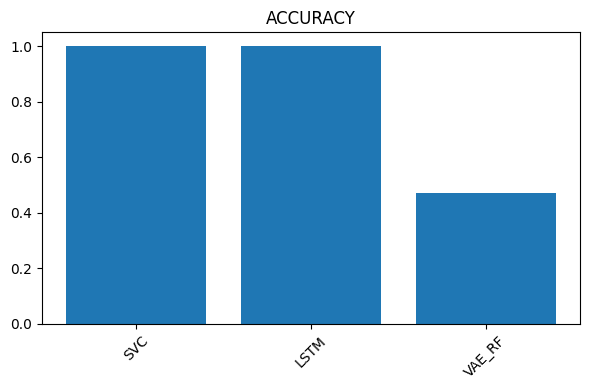

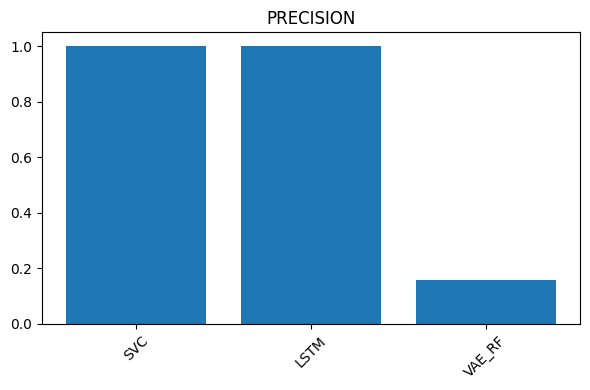

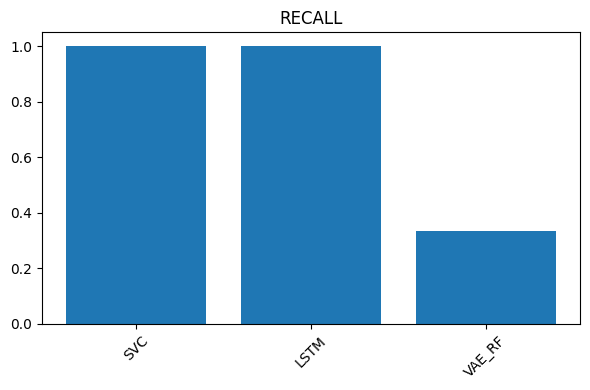

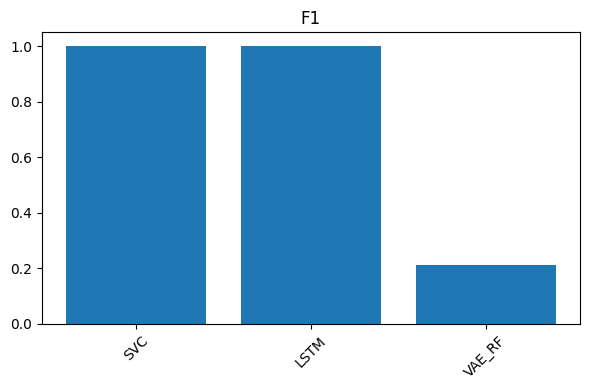

In [82]:
metrics = ["accuracy", "precision", "recall", "f1"]
for m in metrics:
    plt.figure(figsize=(6,4))
    plt.bar(df["Model"], df[m.capitalize()])
    plt.title(m.upper())
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()


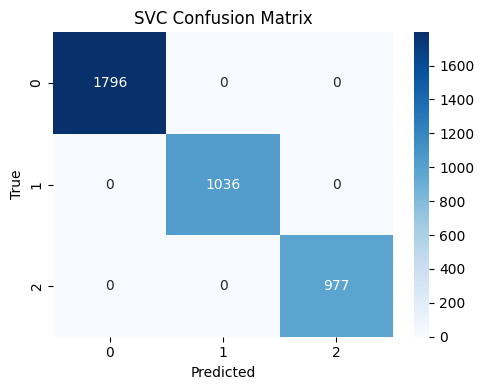

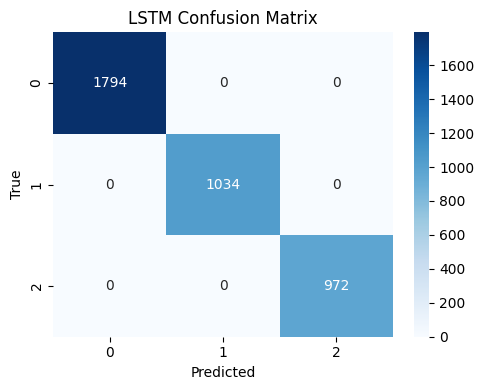

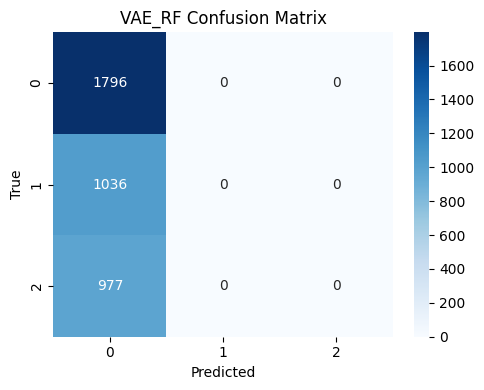

In [83]:
import seaborn as sns

for name, r in eval_data.items():
    plt.figure(figsize=(5,4))
    sns.heatmap(r["cm"], annot=True, fmt="d", cmap="Blues")
    plt.title(f"{name} Confusion Matrix")
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.tight_layout()
    plt.show()


# Part 3: Evaluation helpers and XAI 


In [ ]:

results = []
def eval_and_record(name, model, X_tr, X_te, y_tr, y_te):
    y_pred = model.predict(X_te)
    if y_pred.ndim > 1:
        y_pred = np.argmax(y_pred, axis=1)
    acc = accuracy_score(y_te, y_pred)
    f1 = f1_score(y_te, y_pred, average='macro')
    print(f'{name} Test acc={acc:.4f} f1={f1:.4f}')
    results.append({'model': name, 'accuracy': acc, 'f1_macro': f1})
    display(pd.DataFrame(results).sort_values('f1_macro', ascending=False))

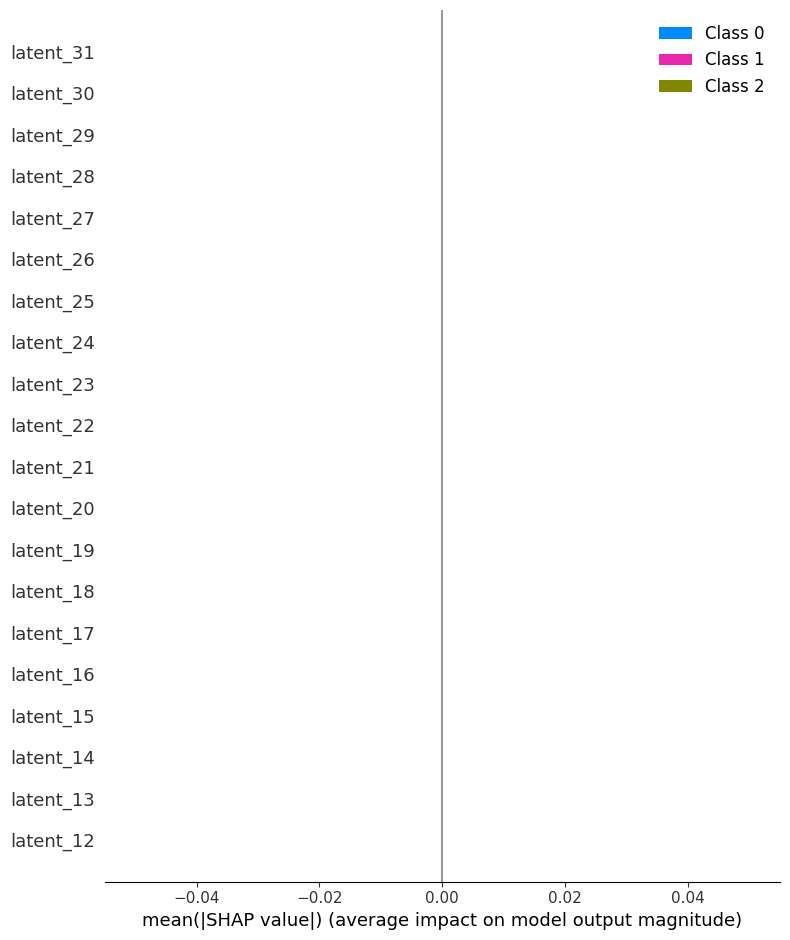

100%|██████████| 100/100 [02:15<00:00,  1.36s/it]


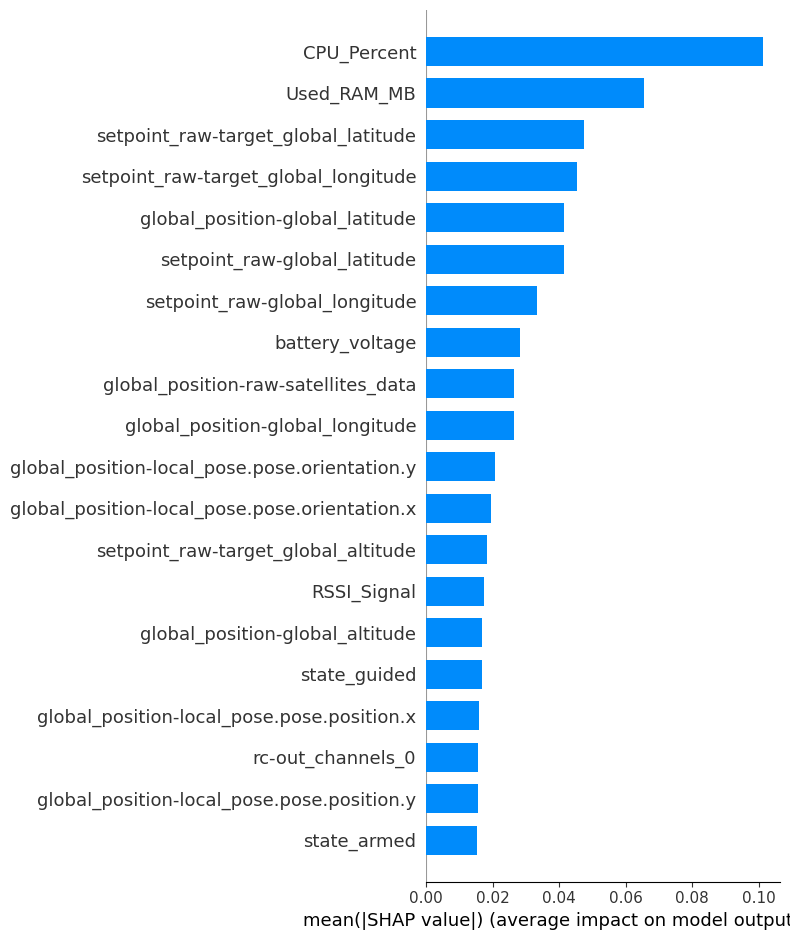

InvalidParameterError: The 'estimator' parameter of permutation_importance must be an object implementing 'fit'. Got <__main__.LSTMWrapper object at 0x000001FD73A5DBB0> instead.

In [ ]:
import shap
import matplotlib.pyplot as plt



feature_names = list(X_train.columns) if 'X_train' in locals() else [f"f{i}" for i in range(X_test_scaled.shape[1])]


explainer_rf = shap.TreeExplainer(clf)
shap_values_rf = explainer_rf.shap_values(z_mean_test)
plt.figure(figsize=(10,6))
shap.summary_plot(shap_values_rf, z_mean_test, feature_names=[f"latent_{i}" for i in range(z_mean_test.shape[1])], plot_type="bar")

svm_sample = X_test_scaled[np.random.choice(X_test_scaled.shape[0], 100, replace=False)]
explainer_svc = shap.KernelExplainer(grid.best_estimator_.predict, svm_sample)
svm_sample_eval = X_test_scaled[np.random.choice(X_test_scaled.shape[0], 100, replace=False)]
shap_values_svc = explainer_svc.shap_values(svm_sample_eval, nsamples=100)
shap.summary_plot(shap_values_svc, svm_sample_eval, feature_names=feature_names, plot_type="bar")

from sklearn.inspection import permutation_importance

X_val_seq_flat = X_val_seq.reshape(X_val_seq.shape[0], -1)
y_val_seq_trimmed = y_val_seq[-X_val_seq_flat.shape[0]:]

class LSTMWrapper:
    def __init__(self, model):
        self.model = model
    def predict(self, X):
        y_pred = self.model.predict(X)
        if y_pred.ndim > 1:
            y_pred = np.argmax(y_pred, axis=1)
        return y_pred

lstm_wrapper = LSTMWrapper(lstm)

perm_importance = permutation_importance(lstm_wrapper, X_val_seq[:100], y_val_seq_trimmed[:100], n_repeats=5, random_state=42)
importance_df = pd.DataFrame({"feature": [f"{col}_t{t}" for t in range(X_val_seq.shape[1]) for col in feature_names],
                              "importance": perm_importance.importances_mean})
importance_df.sort_values("importance", ascending=False, inplace=True)
importance_df.head(20)

explainer_rf = shap.TreeExplainer(clf)
shap_values_rf = explainer_rf.shap_values(z_mean_test)
plt.figure(figsize=(10,6))
shap.summary_plot(shap_values_rf, z_mean_test, feature_names=[f"latent_{i}" for i in range(z_mean_test.shape[1])], plot_type="bar")

svm_sample = X_test_scaled[np.random.choice(X_test_scaled.shape[0], 100, replace=False)]
explainer_svc = shap.KernelExplainer(grid.best_estimator_.predict, svm_sample)
svm_sample_eval = X_test_scaled[np.random.choice(X_test_scaled.shape[0], 100, replace=False)]
shap_values_svc = explainer_svc.shap_values(svm_sample_eval, nsamples=100)
shap.summary_plot(shap_values_svc, svm_sample_eval, feature_names=feature_names, plot_type="bar")

X_val_seq_flat = X_val_seq.reshape(X_val_seq.shape[0], -1)
y_val_seq_trimmed = y_val_seq[-X_val_seq_flat.shape[0]:]

class LSTMWrapper:
    def __init__(self, model):
        self.model = model
    def predict(self, X):
        y_pred = self.model.predict(X)
        if y_pred.ndim > 1:
            y_pred = np.argmax(y_pred, axis=1)
        return y_pred

lstm_wrapper = LSTMWrapper(lstm)

perm_importance = permutation_importance(lstm_wrapper, X_val_seq[:100], y_val_seq_trimmed[:100], n_repeats=5, random_state=42)
importance_df = pd.DataFrame({"feature": [f"{col}_t{t}" for t in range(X_val_seq.shape[1]) for col in feature_names],
                              "importance": perm_importance.importances_mean})
importance_df.sort_values("importance", ascending=False, inplace=True)
importance_df.head(20)


In [ ]:
import shap
import numpy as np
import pandas as pd
from tensorflow import keras


FEATURE_NAMES = [i for i in X_test.columns] 
CLASS_NAMES = ['DoS_Attack', 'Malfunction', 'Normal'] 


X_test_df = pd.DataFrame(X_test_scaled, columns=FEATURE_NAMES)


z_mean_test, _, _ = encoder.predict(X_test_scaled, verbose=0)
LATENT_FEATURE_NAMES = [f'latent_{i}' for i in range(latent_dim)] # latent_dim=32 from your code
z_mean_test_df = pd.DataFrame(z_mean_test, columns=LATENT_FEATURE_NAMES)

In [ ]:
## --- 1. SVC (SVC) XAI ---

X_background = X_test_df.sample(n=100, random_state=42)


svc_explainer = shap.KernelExplainer(grid.best_estimator_.predict, X_background)


svc_shap_values = svc_explainer.shap_values(X_test_df.iloc[:20])
X_test_sample_svc = X_test_df.iloc[:20]


shap.summary_plot(svc_shap_values, X_test_sample_svc, class_names=CLASS_NAMES, show=False)
# 


top_feature_svc = X_test_sample_svc.columns[np.argmax(np.mean(np.abs(svc_shap_values[0]), axis=0))]
print(f"Generating SVC Dependence Plot for the most influential feature: {top_feature_svc}...")

shap.dependence_plot(
    top_feature_svc,
    svc_shap_values[0], # Class 0 explanation
    X_test_sample_svc,
    show=False
)
#

Running SHAP for SVC...


  0%|          | 0/20 [00:00<?, ?it/s]

 50%|█████     | 10/20 [07:32<07:35, 45.53s/it]

In [ ]:

print("\nRunning SHAP for VAE+RandomForest (on Latent Features)...")
vae_rf_explainer = shap.TreeExplainer(clf)


vae_rf_shap_values = vae_rf_explainer.shap_values(z_mean_test_df.iloc[:20])
z_test_sample_vae_rf = z_mean_test_df.iloc[:20]


print("Generating VAE+RF Summary Plot (Latent Feature Importance)...")
shap.summary_plot(vae_rf_shap_values, z_test_sample_vae_rf, class_names=CLASS_NAMES, show=False)
# 


top_latent_feature = z_test_sample_vae_rf.columns[np.argmax(np.mean(np.abs(vae_rf_shap_values[0]), axis=0))]
print(f"Generating VAE+RF Dependence Plot for the most influential latent feature: {top_latent_feature}...")

# 4. Dependence Plot (Latent 1 vs. Output)
shap.dependence_plot(
    top_latent_feature,
    vae_rf_shap_values[0], # Class 0 explanation
    z_test_sample_vae_rf,
    show=False
)
#

In [ ]:

X_seq_background = X_train_seq[:10]

lstm_explainer = shap.DeepExplainer(lstm, X_seq_background)


lstm_shap_values = lstm_explainer.shap_values(X_test_seq[:20]) # Result is a list of 3D arrays


avg_lstm_shap_values_class0 = np.mean(lstm_shap_values[0], axis=1) # (n_samples, n_features)


print("Generating LSTM Summary Plot (Global Feature Importance)...")
shap.summary_plot(avg_lstm_shap_values_class0, X_test_sample_svc, feature_names=FEATURE_NAMES, show=False)

top_feature_lstm_idx = np.argmax(np.mean(np.abs(avg_lstm_shap_values_class0), axis=0))
top_feature_lstm = FEATURE_NAMES[top_feature_lstm_idx]

print(f"Showing LSTM temporal importance for feature {top_feature_lstm} on one sample...")
sample_idx = 10
single_sample_shap = lstm_shap_values[0][sample_idx, :, top_feature_lstm_idx] # SHAP values across time steps
print(f"SHAP values for {top_feature_lstm} across the sequence length (t-10 to t): {single_sample_shap}")